Healthcare Analytics
- Import xlsx file and preview all tabs
- Assess and prep data: Clean column names, handle missing data, normalise fields
- Merge datasets on common identifiers (product, dose, etc)
- Perform analysis:
    Time trend,
    Dose comparison,
    Cost analysis,
    Setting split,
    Correlation
- Dashbaord app: 
    Useage trend,
    KPI
- Additional step:
    Create api integration to demonstrate how data can feed dashboards

In [ ]:
# import libaries, update pip and save as requirements.txt
!pip install --upgrade pip
!pip install pandas numpy matplotlib seaborn plotly openpyxl streamlit statsmodels prophet geopandas pycountry-convert
!pip freeze > requirements.txt

In [ ]:
# Install packages into the same environment being used
import sys
!{sys.executable} -m pip install plotly statsmodels prophet geopandas pycountry-convert

  Using cached prophet-1.2.1-py3-none-macosx_11_0_arm64.whl.metadata (3.5 kB)
  Using cached prophet-1.2.1-py3-none-macosx_11_0_arm64.whl.metadata (3.5 kB)
  Using cached geopandas-1.1.1-py3-none-any.whl.metadata (2.3 kB)
  Using cached pycountry_convert-0.7.2-py3-none-any.whl.metadata (7.2 kB)
  Using cached geopandas-1.1.1-py3-none-any.whl.metadata (2.3 kB)
  Using cached pycountry_convert-0.7.2-py3-none-any.whl.metadata (7.2 kB)
  Using cached cmdstanpy-1.3.0-py3-none-any.whl.metadata (4.2 kB)
  Using cached cmdstanpy-1.3.0-py3-none-any.whl.metadata (4.2 kB)
  Using cached holidays-0.84-py3-none-any.whl.metadata (50 kB)
  Using cached holidays-0.84-py3-none-any.whl.metadata (50 kB)
  Using cached tqdm-4.67.1-py3-none-any.whl.metadata (57 kB)
  Using cached tqdm-4.67.1-py3-none-any.whl.metadata (57 kB)
  Using cached importlib_resources-6.5.2-py3-none-any.whl.metadata (3.9 kB)
  Using cached importlib_resources-6.5.2-py3-none-any.whl.metadata (3.9 kB)
  Using cached pprintpp-0.4.0-py

In [128]:
# Core libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Date/time
from datetime import datetime

# Forecasting
from statsmodels.tsa.api import ExponentialSmoothing
# (Later, optionally: from prophet import Prophet)

# Display settings
pd.set_option('display.max_columns', None)
plt.style.use('seaborn-v0_8')

In [140]:
# Load data, explore basic info
file_path = "Input_File.xlsx"
df = pd.read_excel(file_path)

df.shape
df.info()
df.describe(include='all')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6730 entries, 0 to 6729
Data columns (total 87 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   ICB_Code        6730 non-null   object 
 1   ICB_Name        6730 non-null   object 
 2   Practice_Code   6730 non-null   object 
 3   Practice_Name   6730 non-null   object 
 4   Post_Code       6671 non-null   object 
 5   BNF_Code        6730 non-null   object 
 6   BNF_Name        6730 non-null   object 
 7   Product_Group   6730 non-null   object 
 8   Quviviq_Type    6730 non-null   object 
 9   QtyMAT          6730 non-null   int64  
 10  NICMAT          6730 non-null   float64
 11  ITEMSMAT        6730 non-null   int64  
 12  QtyYTD          6730 non-null   int64  
 13  NICYTD          6730 non-null   float64
 14  ITEMSYTD        6730 non-null   int64  
 15  Jul-2023_QTY    6730 non-null   int64  
 16  Aug-2023_QTY    6730 non-null   int64  
 17  Sep-2023_QTY    6730 non-null   i

,ICB_Code,ICB_Name,Practice_Code,Practice_Name,Post_Code,BNF_Code,BNF_Name,Product_Group,Quviviq_Type,QtyMAT,NICMAT,ITEMSMAT,QtyYTD,NICYTD,ITEMSYTD,Jul-2023_QTY,Aug-2023_QTY,Sep-2023_QTY,Oct-2023_QTY,Nov-2023_QTY,Dec-2023_QTY,Jan-2024_QTY,Feb-2024_QTY,Mar-2024_QTY,Apr-2024_QTY,May-2024_QTY,Jun-2024_QTY,Jul-2024_QTY,Aug-2024_QTY,Sep-2024_QTY,Oct-2024_QTY,Nov-2024_QTY,Dec-2024_QTY,Jan-2025_QTY,Feb-2025_QTY,Mar-2025_QTY,Apr-2025_QTY,May-2025_QTY,Jun-2025_QTY,Jul-2023_NIC,Aug-2023_NIC,Sep-2023_NIC,Oct-2023_NIC,Nov-2023_NIC,Dec-2023_NIC,Jan-2024_NIC,Feb-2024_NIC,Mar-2024_NIC,Apr-2024_NIC,May-2024_NIC,Jun-2024_NIC,Jul-2024_NIC,Aug-2024_NIC,Sep-2024_NIC,Oct-2024_NIC,Nov-2024_NIC,Dec-2024_NIC,Jan-2025_NIC,Feb-2025_NIC,Mar-2025_NIC,Apr-2025_NIC,May-2025_NIC,Jun-2025_NIC,Jul-2023_ITEMS,Aug-2023_ITEMS,Sep-2023_ITEMS,Oct-2023_ITEMS,Nov-2023_ITEMS,Dec-2023_ITEMS,Jan-2024_ITEMS,Feb-2024_ITEMS,Mar-2024_ITEMS,Apr-2024_ITEMS,May-2024_ITEMS,Jun-2024_ITEMS,Jul-2024_ITEMS,Aug-2024_ITEMS,Sep-2024_ITEMS,Oct-2024_ITEMS,Nov-2024_ITEMS,Dec-2024_ITEMS,Jan-2025_ITEMS,Feb-2025_ITEMS,Mar-2025_ITEMS,Apr-2025_ITEMS,May-2025_ITEMS,Jun-2025_ITEMS
count,6730,6730,6730,6730,6671,6730,6730,6730,6730,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.0,6730.0,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.0,6730.0,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.0,6730.0,6730.000000,6730.000000,6730.000000,6730.0000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000
unique,43,77,4168,4046,3822,4,4,2,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,QYG,NHS Cheshire And Merseyside Integrated Care Board,RXT,Woodlands Surgery,SK11 6JL,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,535,524,6,9,12,3439,3439,3626,6511,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,290.076226,406.106716,9.832689,205.608767,287.852273,7.004160,0.0,0.0,0.004458,0.017831,0.354978,0.643982,1.194354,2.112779,3.314710,4.595542,5.636850,6.135215,8.524517,9.884993,11.331649,15.488410,18.140267,21.097623,25.881278,27.087667,32.083804,34.377266,40.535661,45.643091,0.0,0.0,0.006241,0.024963,0.496969,0.901575,1.672095,2.957890,4.640594,6.433759,7.891590,8.589302,11.934324,13.838990,15.864309,21.683774,25.396374,29.536672,36.233789,37.922734,44.917325,48.128172,56.749926,63.900327,0.0,0.0,0.000149,0.000594,0.011293,0.0211,0.039673,0.068351,0.110550,0.147697,0.186181,0.198960,0.282318,0.334324,0.377117,0.518276,0.613819,0.705944,0.875632,0.914562,1.086627,1.173254,1.384993,1.572065
std,NaN,Na

In [138]:
df.head()

,ICB_Code,ICB_Name,Practice_Code,Practice_Name,Post_Code,BNF_Code,BNF_Name,Product_Group,Quviviq_Type,QtyMAT,NICMAT,ITEMSMAT,QtyYTD,NICYTD,ITEMSYTD,Jul-2023_QTY,Aug-2023_QTY,Sep-2023_QTY,Oct-2023_QTY,Nov-2023_QTY,Dec-2023_QTY,Jan-2024_QTY,Feb-2024_QTY,Mar-2024_QTY,Apr-2024_QTY,May-2024_QTY,Jun-2024_QTY,Jul-2024_QTY,Aug-2024_QTY,Sep-2024_QTY,Oct-2024_QTY,Nov-2024_QTY,Dec-2024_QTY,Jan-2025_QTY,Feb-2025_QTY,Mar-2025_QTY,Apr-2025_QTY,May-2025_QTY,Jun-2025_QTY,Jul-2023_NIC,Aug-2023_NIC,Sep-2023_NIC,Oct-2023_NIC,Nov-2023_NIC,Dec-2023_NIC,Jan-2024_NIC,Feb-2024_NIC,Mar-2024_NIC,Apr-2024_NIC,May-2024_NIC,Jun-2024_NIC,Jul-2024_NIC,Aug-2024_NIC,Sep-2024_NIC,Oct-2024_NIC,Nov-2024_NIC,Dec-2024_NIC,Jan-2025_NIC,Feb-2025_NIC,Mar-2025_NIC,Apr-2025_NIC,May-2025_NIC,Jun-2025_NIC,Jul-2023_ITEMS,Aug-2023_ITEMS,Sep-2023_ITEMS,Oct-2023_ITEMS,Nov-2023_ITEMS,Dec-2023_ITEMS,Jan-2024_ITEMS,Feb-2024_ITEMS,Mar-2024_ITEMS,Apr-2024_ITEMS,May-2024_ITEMS,Jun-2024_ITEMS,Jul-2024_ITEMS,Aug-2024_ITEMS,Sep-2024_ITEMS,Oct-2024_ITEMS,Nov-2024_ITEMS,Dec-2024_ITEMS,Jan-2025_ITEMS,Feb-2025_ITEMS,Mar-2025_ITEMS,Apr-2025_ITEMS,May-2025_ITEMS,Jun-2025_ITEMS
0,QHM,NHS North East And North Cumbria Integrated Ca...,A84006,Alnwick Medical Group,NE66 2NL,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,30,42.0,1,30,42.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,QHM,NHS North East And North Cumbria Integrated Ca...,A84005,Bedlingtonshire Med.Group,NE22 6JX,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,210,294.0,7,210,294.0,7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,60,30,30,60,0,30,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,84.0,42.0,42.0,84.0,0.0,42.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,1,1,2,0,1
2,QHM,NHS North East And North Cumbria Integrated Ca...,A84024,Burn Brae Medical Group,NE46 1QJ,0401040A0AAAAAA,Daridorexant 25mg tablets,Quviviq 25,Primary,0,0.0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,QHM,NHS North East And North Cumbria Integrated Ca...,A84022,Coquet Medical Group,NE65 0HD,0401040A0AAAAAA,Daridorexant 25mg tablets,Quviviq 25,Primary,60,84.0,2,60,84.0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30,0,30,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,42.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0
4,QHM,NHS North East And North Cumbria Integrated Ca...,A84022,Coquet Medical Group,NE65 0HD,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,30,42.0,1,30,42.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [143]:
# Group monthly QTY, NIC, ITEMS columns
qty_cols   = [c for c in df.columns if "_QTY" in c]
nic_cols   = [c for c in df.columns if "_NIC" in c]
items_cols = [c for c in df.columns if "_ITEMS" in c]

# Group aggregates
mat_cols = [c for c in df.columns if "MAT" in c]
ytd_cols = [c for c in df.columns if "YTD" in c]

print("QTY cols:", len(qty_cols))
print("NIC cols:", len(nic_cols))
print("ITEMS cols:", len(items_cols))
print("MAT cols:", len(mat_cols))
print("YTD cols:", len(ytd_cols))

QTY cols: 24
NIC cols: 24
ITEMS cols: 24
MAT cols: 3
YTD cols: 3


In [149]:
# Check for missing post codes
df['Post_Code'].isna().sum()

np.int64(59)

In [ ]:
# Save cleaned data
cleaned_path = "Input_File_cleaned.csv"
df.to_csv(cleaned_path, index=False)

In [29]:
#import libraries
import pandas as pd

# Load xslx file into a dictionary of DataFrames
file_path = "SynapsysIQ-SimpleDataReview.xlsx"
sheets = pd.read_excel(file_path, sheet_name=None)

# List available sheet names to avoid KeyError
sheet_names = list(sheets.keys())
print("Available sheets:", sheet_names)

Available sheets: ['Overview', 'Quviviq Primary', 'Quviviq Hosp Community', 'Quviviq Hospital', 'Product Grouping']


In [32]:
# Print the shape and first 5 rows of each sheet
for name, df in sheets.items():
    print(f"{name} -> {df.shape}")
    print(df.head())

Overview -> (0, 0)
Empty DataFrame
Columns: []
Index: []
Quviviq Primary -> (6511, 85)
  ICB Code                          ICB Name Practice Code  \
0      QHM  North East And North Cumbria ICB        A84006   
1      QHM  North East And North Cumbria ICB        A84005   
2      QHM  North East And North Cumbria ICB        A84024   
3      QHM  North East And North Cumbria ICB        A84022   
4      QHM  North East And North Cumbria ICB        A84022   

               Practice Name  PostCode         BNF Code  \
0      Alnwick Medical Group  NE66 2NL  0401040A0AAABAB   
1  Bedlingtonshire Med.Group  NE22 6JX  0401040A0AAABAB   
2    Burn Brae Medical Group  NE46 1QJ  0401040A0AAAAAA   
3       Coquet Medical Group  NE65 0HD  0401040A0AAAAAA   
4       Coquet Medical Group  NE65 0HD  0401040A0AAABAB   

                    BNF Name  QtyMAT  NICMAT  ITEMSMAT  ...  Sep-2024 ITEMS  \
0  Daridorexant 50mg tablets      30    42.0         1  ...               0   
1  Daridorexant 50mg tablet

In [57]:
import pandas as pd

# Load your data
df = pd.read_excel("/Users/sharif.imam/Downloads/checkspython.xlsx")

# --- CLEAN PRACTICE NAMES ---
df["PracticeName_clean"] = (
    df["PracticeName"]
    .astype(str)
    .str.strip()           # remove leading/trailing spaces
    .str.lower()           # ignore case differences
    .str.replace(r"\s+", " ", regex=True)  # collapse multiple spaces
)

# 1️⃣ Check for full-row duplicates
duplicates = df[df.duplicated()]
print("Full-row duplicates:")
print(duplicates)

# 2️⃣ Check if Practice Name maps to multiple codes/postcodes
name_to_code = df.groupby("PracticeName_clean")["PracticeCode"].nunique()
name_to_post = df.groupby("PracticeName_clean")["PostCode"].nunique()

print("\nPractice Names with multiple codes:")
print(name_to_code[name_to_code > 1])

print("\nPractice Names with multiple postcodes:")
print(name_to_post[name_to_post > 1])

# 3️⃣ Check if Practice Code maps to multiple names/postcodes
code_to_name = df.groupby("PracticeCode")["PracticeName_clean"].nunique()
code_to_post = df.groupby("PracticeCode")["PostCode"].nunique()

print("\nPractice Codes with multiple names:")
print(code_to_name[code_to_name > 1])

print("\nPractice Codes with multiple postcodes:")
print(code_to_post[code_to_post > 1])


Full-row duplicates:
Empty DataFrame
Columns: [ICB Code, ICB Name, PracticeCode, PracticeName, PostCode, BNF Code, BNF Name, QtyMAT, NICMAT, ITEMSMAT, QtyYTD, NICYTD, ITEMSYTD, 2023-07-01 00:00:00, 2023-08-01 00:00:00, 2023-09-01 00:00:00, 2023-10-01 00:00:00, 2023-11-01 00:00:00, 2023-12-01 00:00:00, 2024-01-01 00:00:00, 2024-02-01 00:00:00, 2024-03-01 00:00:00, 2024-04-01 00:00:00, 2024-05-01 00:00:00, 2024-06-01 00:00:00, 2024-07-01 00:00:00, 2024-08-01 00:00:00, 2024-09-01 00:00:00, 2024-10-01 00:00:00, 2024-11-01 00:00:00, 2024-12-01 00:00:00, 2025-01-01 00:00:00, 2025-02-01 00:00:00, 2025-03-01 00:00:00, 2025-04-01 00:00:00, 2025-05-01 00:00:00, 2025-06-01 00:00:00, Jul-2023 NIC, Aug-2023 NIC, Sep-2023 NIC, Oct-2023 NIC, Nov-2023 NIC, Dec-2023 NIC, Jan-2024 NIC, Feb-2024 NIC, Mar-2024 NIC, Apr-2024 NIC, May-2024 NIC, Jun-2024 NIC, Jul-2024 NIC, Aug-2024 NIC, Sep-2024 NIC, Oct-2024 NIC, Nov-2024 NIC, Dec-2024 NIC, Jan-2025 NIC, Feb-2025 NIC, Mar-2025 NIC, Apr-2025 NIC, May-2025 NI

In [48]:
name_to_code[name_to_code > 1]

PracticeName_clean
abbey medical centre          4
abbey medical practice        2
ashville surgery              2
belgrave medical centre       2
birchwood medical practice    2
                             ..
white house surgery           2
woodlands health centre       2
woodlands medical practice    4
woodlands surgery             5
woodside medical centre       2
Name: PracticeCode, Length: 112, dtype: int64

In [49]:
name_to_post[name_to_post > 1]

PracticeName_clean
abbey medical centre          4
abbey medical practice        2
ashville surgery              2
belgrave medical centre       2
birchwood medical practice    2
                             ..
white house surgery           2
woodlands health centre       2
woodlands medical practice    4
woodlands surgery             5
woodside medical centre       2
Name: PostCode, Length: 112, dtype: int64

In [50]:
code_to_name[code_to_name > 1]

Series([], Name: PracticeName_clean, dtype: int64)

In [51]:
code_to_post[code_to_post > 1]

Series([], Name: PostCode, dtype: int64)

In [52]:
# 3️⃣ ICB-LEVEL QUALITY CHECKS
icbname_to_code = df.groupby("ICB Name")["ICB Code"].nunique()
icbcode_to_name = df.groupby("ICB Code")["ICB Name"].nunique()

print("\nICB Names with multiple codes:")
display(icbname_to_code[icbname_to_code > 1])

print("\nICB Codes with multiple names:")
display(icbcode_to_name[icbcode_to_name > 1])


ICB Names with multiple codes:


Series([], Name: ICB Code, dtype: int64)


ICB Codes with multiple names:


Series([], Name: ICB Name, dtype: int64)

In [53]:
duplicate_practice_names = df["PracticeName"].value_counts()
duplicate_practice_names = duplicate_practice_names[duplicate_practice_names > 1]
print("Duplicate Practice Names and their counts:")
display(duplicate_practice_names)

Duplicate Practice Names and their counts:


PracticeName
Woodlands Surgery               9
Central Surgery                 8
Church Lane Surgery             8
Park Surgery                    8
Woodlands Medical Practice      7
                               ..
Huntingdon Road Surgery         2
Gratton Surgery                 2
Great Staughton Surgery         2
Granta Medical Practices        2
The Grantham Centre Practice    2
Name: count, Length: 2179, dtype: int64

In [54]:
distinct_practice_names_count = df["PracticeName"].nunique()
print(f"Number of distinct Practice Names: {distinct_practice_names_count}")

Number of distinct Practice Names: 3923


In [60]:
 # Count NaN (empty) cells across each row
df["EmptyCellCount"] = df.isna().sum(axis=1)

In [ ]:
total_empty_cells = df.isna().sum().sum()
print(f"Total empty cells in dataset: {total_empty_cells}")

Total empty cells in dataset: 0


Start

In [86]:
#import libraries
import pandas as pd
import matplotlib.pyplot as plt

# Load your data
data = pd.read_excel("Input_File.xlsx")

data.head()

,ICB_Code,ICB_Name,Practice_Code,Practice_Name,Post_Code,BNF_Code,BNF_Name,Product_Group,Quviviq_Type,QtyMAT,...,Sep-2024_ITEMS,Oct-2024_ITEMS,Nov-2024_ITEMS,Dec-2024_ITEMS,Jan-2025_ITEMS,Feb-2025_ITEMS,Mar-2025_ITEMS,Apr-2025_ITEMS,May-2025_ITEMS,Jun-2025_ITEMS
0,QHM,NHS North East And North Cumbria Integrated Ca...,A84006,Alnwick Medical Group,NE66 2NL,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,30,...,0,0,0,0,0,0,0,0,0,1
1,QHM,NHS North East And North Cumbria Integrated Ca...,A84005,Bedlingtonshire Med.Group,NE22 6JX,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,210,...,0,0,0,0,2,1,1,2,0,1
2,QHM,NHS North East And North Cumbria Integrated Ca...,A84024,Burn Brae Medical Group,NE46 1QJ,0401040A0AAAAAA,Daridorexant 25mg tablets,Quviviq 25,Primary,0,...,0,0,0,0,0,0,0,0,0,0
3,QHM,NHS North East And North Cumbria Integrated Ca...,A84022,Coquet Medical Group,NE65 0HD,0401040A0AAAAAA,Daridorexant 25mg tablets,Quviviq 25,Primary,60,...,0,0,0,0,0,1,0,1,0,0
4,QHM,NHS North East And North Cumbria Integrated Ca...,A84022,Coquet Medical Group,NE65 0HD,0401040A0AAABAB,Daridorexant 50mg tablets,Quviviq 50,Primary,30,...,0,0,0,0,0,0,0,1,0,0


In [87]:
data.shape

(6730, 87)

In [101]:
data.describe()

,QtyMAT,NICMAT,ITEMSMAT,QtyYTD,NICYTD,ITEMSYTD,Jul-2023_QTY,Aug-2023_QTY,Sep-2023_QTY,Oct-2023_QTY,...,Sep-2024_ITEMS,Oct-2024_ITEMS,Nov-2024_ITEMS,Dec-2024_ITEMS,Jan-2025_ITEMS,Feb-2025_ITEMS,Mar-2025_ITEMS,Apr-2025_ITEMS,May-2025_ITEMS,Jun-2025_ITEMS
count,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.0,6730.0,6730.000000,6730.000000,...,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000,6730.000000
mean,290.076226,406.106716,9.832689,205.608767,287.852273,7.004160,0.0,0.0,0.004458,0.017831,...,0.377117,0.518276,0.613819,0.705944,0.875632,0.914562,1.086627,1.173254,1.384993,1.572065
std,525.538892,735.754448,18.461407,363.723213,509.212499,12.932061,0.0,0.0,0.365691,1.156363,...,1.198954,1.416956,1.549084,1.667442,1.953726,2.027522,2.330811,2.362082,2.703165,2.975941
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,-1.000000,-1.000000,-2.000000
25%,30.000000,42.000000,1.000000,30.000000,42.000000,1.000000,0.0,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,120.000000,168.000000,4.000000,90.000000,126.000000,3.000000,0.0,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
75%,330.000000,462.000000,11.000000,240.000000,336.000000,7.000000,0.0,0.0,0.000000,0.000000,...,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,2.000000
max,11786.000000,16500.400000,353.000000,7514.000000,10519.600000,228.000000,0.0,0.0,30.000000,90.000000,...,32.000000,30.000000,32.000000,31.000000,29.000000,34.000000,37.000000,36.000000,51.000000,53.000000


<Axes: >

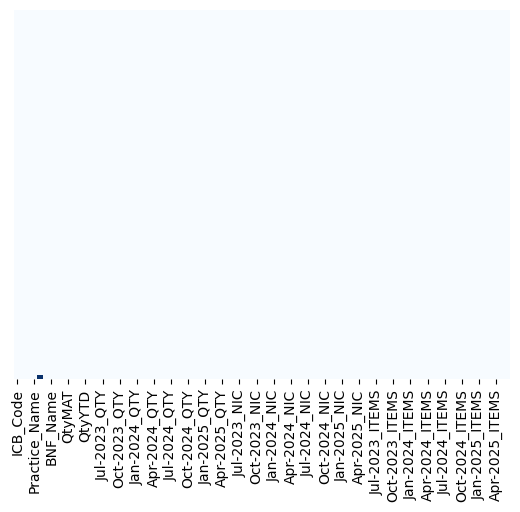

In [102]:
# check if there are any Null values
sns.heatmap(data.isnull(), yticklabels = False, cbar = False, cmap="Blues")

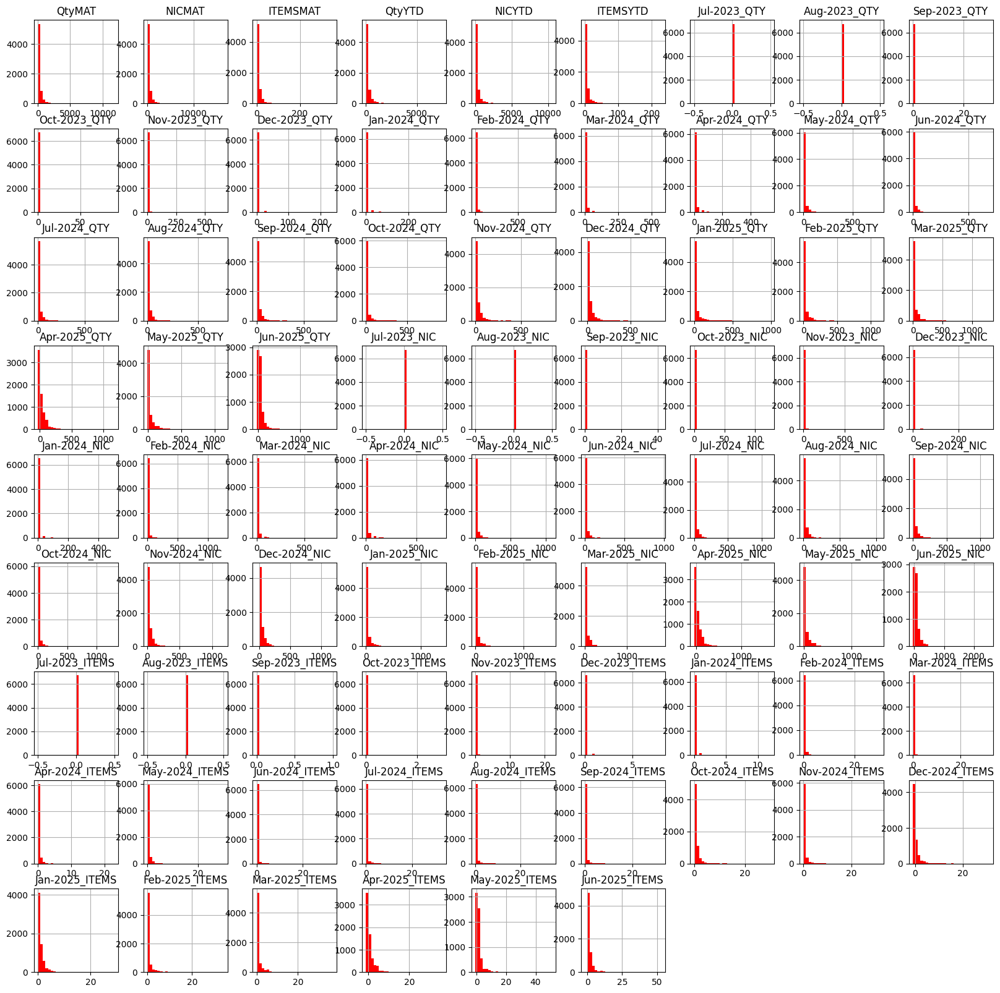

In [103]:
# Plot the histogram
data.hist(bins = 30, figsize = (20, 20), color = 'r');

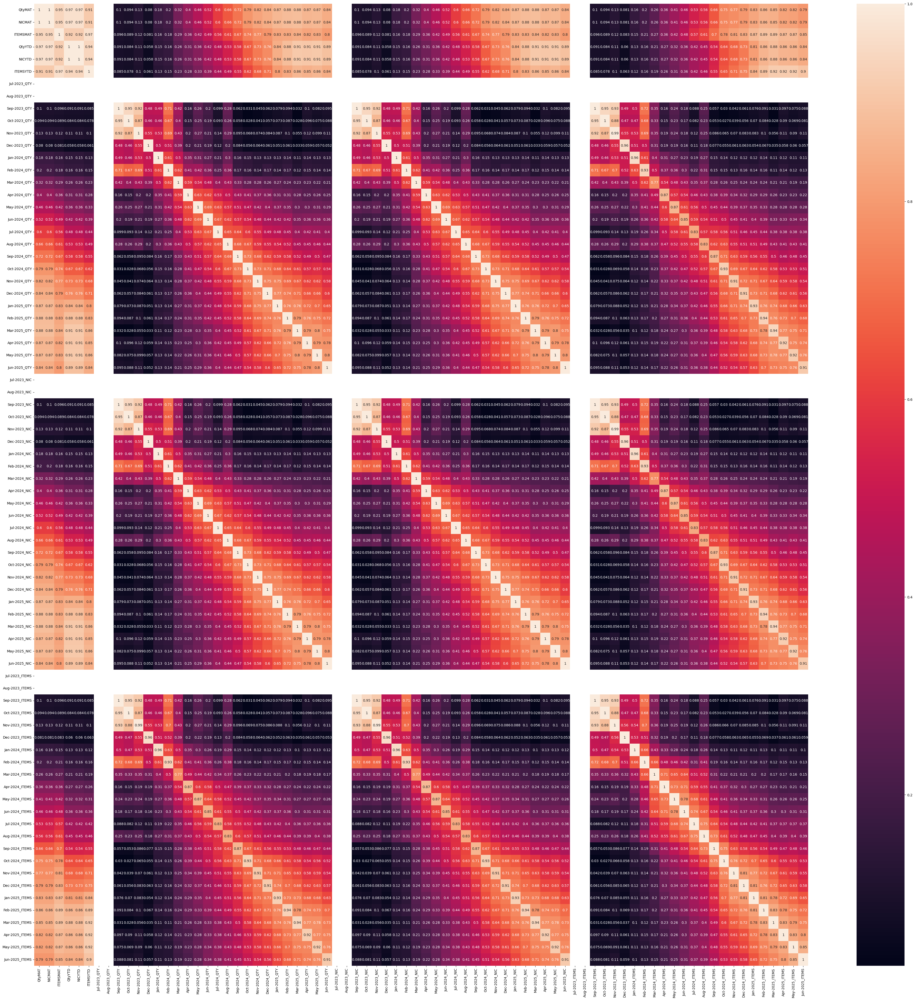

In [106]:
# Plot the correlation matrix
plt.figure(figsize = (50,50))
corr_matrix = data.select_dtypes(include=['number']).corr() # select only numeric columns for correlation matrix
sns.heatmap(corr_matrix, annot = True)
plt.show()

In [107]:
data.isnull().sum()

ICB_Code           0
ICB_Name           0
Practice_Code      0
Practice_Name      0
Post_Code         59
                  ..
Feb-2025_ITEMS     0
Mar-2025_ITEMS     0
Apr-2025_ITEMS     0
May-2025_ITEMS     0
Jun-2025_ITEMS     0
Length: 87, dtype: int64

In [110]:
import numpy as np

# Check the number of null values for the columns having null values
data.isnull().sum()[np.where(data.isnull().sum() != 0)[0]]

/var/folders/mj/8nscqbcd20v1t4brm5hn9l10k52q5k/T/ipykernel_74400/597435339.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  data.isnull().sum()[np.where(data.isnull().sum() != 0)[0]]


Post_Code    59
dtype: int64

In [112]:
sns.pairplot(data)
plt.show()

In [ ]:
#data.columns = [
#    col if "00:00:00" not in str(col)
#    else pd.to_datetime(col).strftime("%b-%Y QTY")
#    for col in data.columns
#]

In [88]:
data.dtypes

ICB_Code          object
ICB_Name          object
Practice_Code     object
Practice_Name     object
Post_Code         object
                   ...  
Feb-2025_ITEMS     int64
Mar-2025_ITEMS     int64
Apr-2025_ITEMS     int64
May-2025_ITEMS     int64
Jun-2025_ITEMS     int64
Length: 87, dtype: object

<Axes: title={'center': 'QtyMAT vs NICMAT Scatter Plot'}, xlabel='QtyMAT', ylabel='NICMAT'>

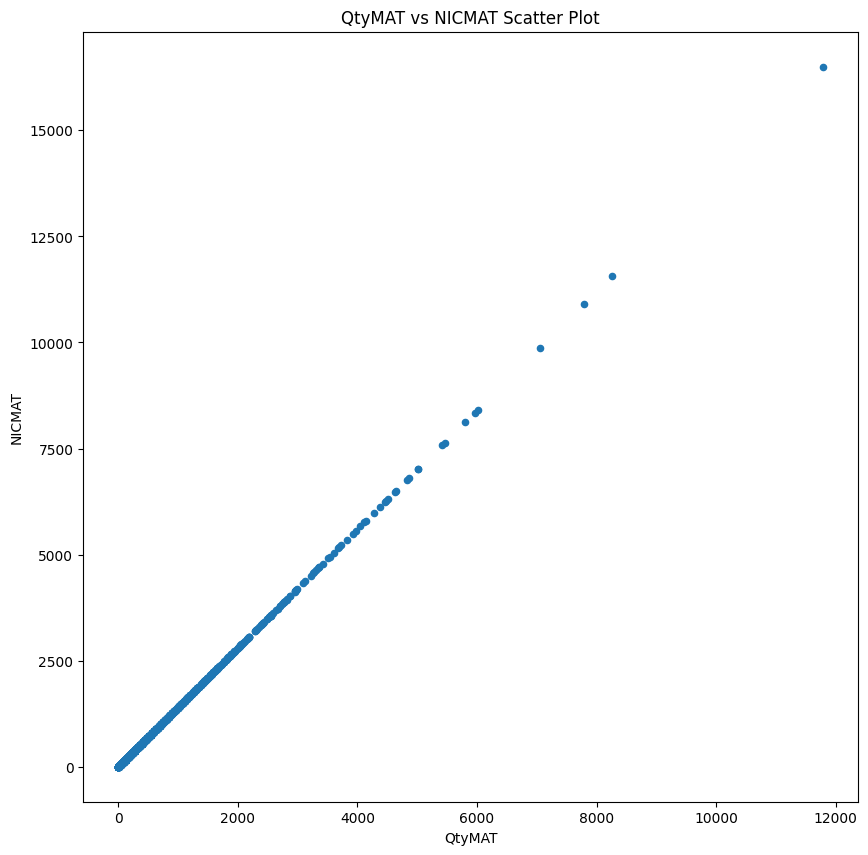

In [89]:
data.plot.scatter(x="QtyMAT", y="NICMAT", figsize=(10,10), title="QtyMAT vs NICMAT Scatter Plot")

In [90]:
corr_matrix = data.corr(numeric_only=True)
print(corr_matrix)

                  QtyMAT    NICMAT  ITEMSMAT    QtyYTD    NICYTD  ITEMSYTD  \
QtyMAT          1.000000  1.000000  0.945349  0.971706  0.971706  0.914839   
NICMAT          1.000000  1.000000  0.945349  0.971706  0.971706  0.914839   
ITEMSMAT        0.945349  0.945349  1.000000  0.923536  0.923536  0.968041   
QtyYTD          0.971706  0.971706  0.923536  1.000000  1.000000  0.944843   
NICYTD          0.971706  0.971706  0.923536  1.000000  1.000000  0.944843   
...                  ...       ...       ...       ...       ...       ...   
Feb-2025_ITEMS  0.855479  0.855479  0.892891  0.860750  0.860750  0.893353   
Mar-2025_ITEMS  0.851085  0.851085  0.890255  0.881722  0.881722  0.919231   
Apr-2025_ITEMS  0.820348  0.820348  0.873962  0.862745  0.862745  0.920073   
May-2025_ITEMS  0.816975  0.816975  0.871732  0.856138  0.856138  0.919530   
Jun-2025_ITEMS  0.793936  0.793936  0.845029  0.840278  0.840278  0.899875   

                Jul-2023_QTY  Aug-2023_QTY  Sep-2023_QTY  Oct-2

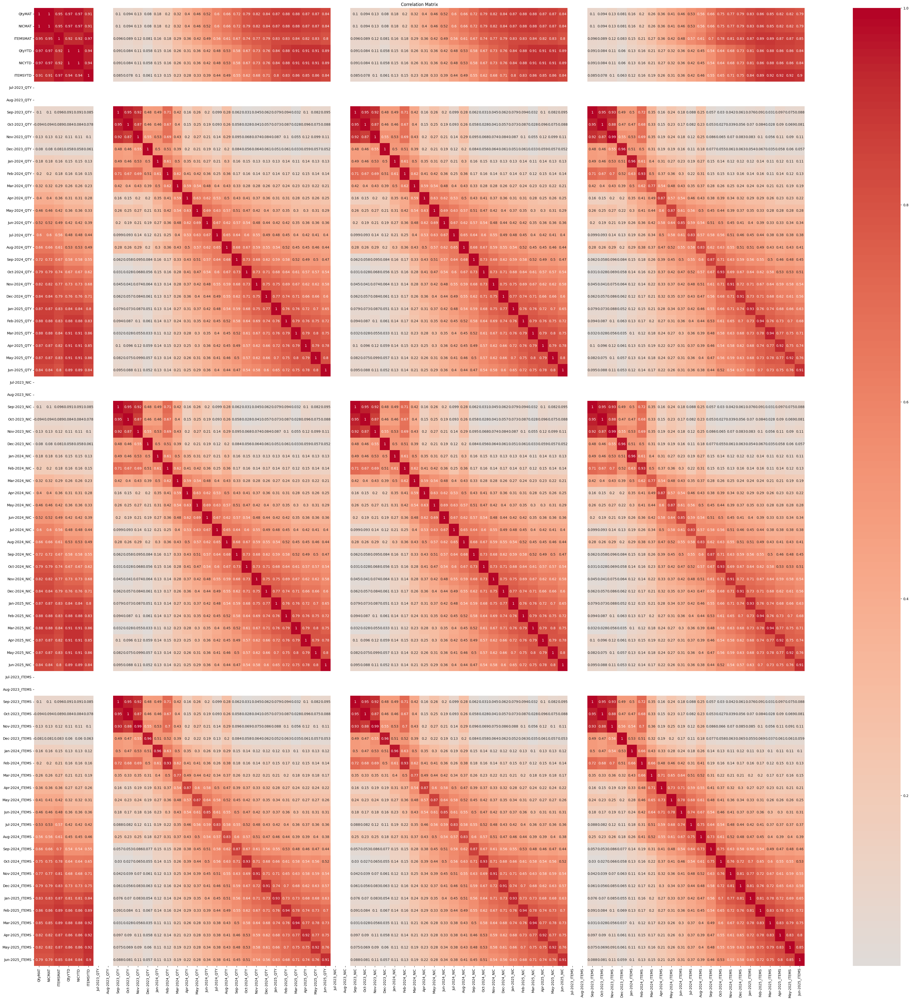

In [91]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(50,50))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Matrix")
plt.show()

In [93]:
# select columns by index (15 to 38 because Python is 0-based)
data_subset = data.iloc[:, 15:39]
data_subset.head()

,Jul-2023_QTY,Aug-2023_QTY,Sep-2023_QTY,Oct-2023_QTY,Nov-2023_QTY,Dec-2023_QTY,Jan-2024_QTY,Feb-2024_QTY,Mar-2024_QTY,Apr-2024_QTY,...,Sep-2024_QTY,Oct-2024_QTY,Nov-2024_QTY,Dec-2024_QTY,Jan-2025_QTY,Feb-2025_QTY,Mar-2025_QTY,Apr-2025_QTY,May-2025_QTY,Jun-2025_QTY
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,30
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,60,30,30,60,0,30
2,0,0,0,0,0,0,0,0,0,30,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,30,0,30,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,30,0,0


In [94]:
# === 2️⃣ Select your month columns (columns P–AM = 13:37) ===
data_subset = data.iloc[:, 15:39]  # adjust if off by 1 depending on your file
print("Month columns detected:", data_subset.columns.tolist())

Month columns detected: ['Jul-2023_QTY', 'Aug-2023_QTY', 'Sep-2023_QTY', 'Oct-2023_QTY', 'Nov-2023_QTY', 'Dec-2023_QTY', 'Jan-2024_QTY', 'Feb-2024_QTY', 'Mar-2024_QTY', 'Apr-2024_QTY', 'May-2024_QTY', 'Jun-2024_QTY', 'Jul-2024_QTY', 'Aug-2024_QTY', 'Sep-2024_QTY', 'Oct-2024_QTY', 'Nov-2024_QTY', 'Dec-2024_QTY', 'Jan-2025_QTY', 'Feb-2025_QTY', 'Mar-2025_QTY', 'Apr-2025_QTY', 'May-2025_QTY', 'Jun-2025_QTY']


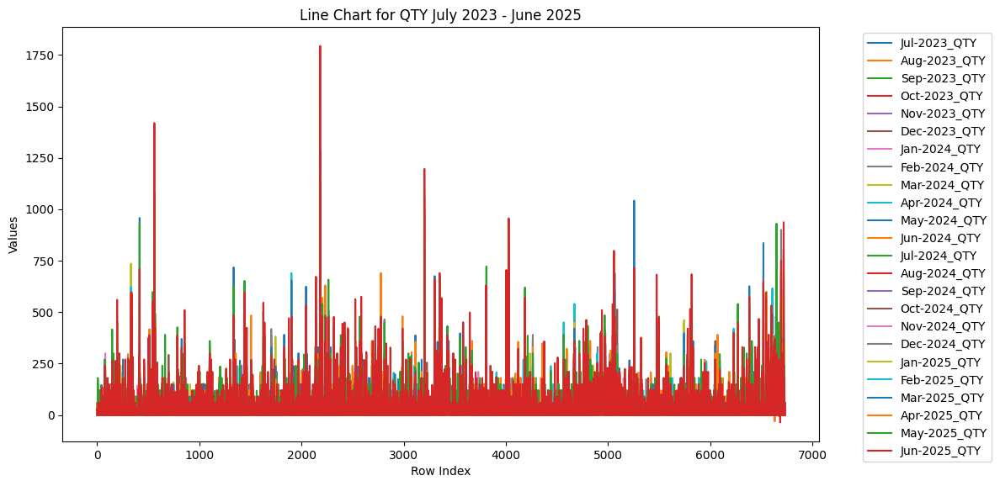

In [99]:
plt.figure(figsize=(12,6))
plt.plot(data_subset)
plt.title("Line Chart for QTY July 2023 - June 2025")
plt.xlabel("Row Index")
plt.ylabel("Values")
plt.legend(data_subset.columns, bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

In [ ]:
ax = count_per_year.plot(figsize=(8,6))
ax.set_xlabel("years")
ax.set_ylabel("movies")